# 1D2D模型代码

In [1]:
import os
import shutil
from pyswmm import Simulation, Nodes
import pandas as pd
from osgeo import gdal
import numpy as np
from utils import initial, before_step, scan


In [2]:
cwd = os.getcwd()
os.chdir(os.path.join(cwd,'workdir'))

In [28]:
name = '200y'

In [29]:
# 运行第一个时间步长的2d-model和swmm模型
sim = Simulation(f'CModel_{name}.inp')
sim.step_advance(30)
sim.start()
sim.next()
initial(name)   # 重写parfile，模型从头开始运行
# lf_path = os.path.join(cwd,'Lisflood-fp-5.9','lisflood-fp-bristol','lisflood.exe')
os.system('lisflood.exe -log '+f'{name}.par')  # 第一次运行
print('lisflood is running the first time..')

lisflood is running the first time..


In [30]:

# 开始一个步长一个步长的循环计算
t = 1
manhole_chart = pd.read_csv('Interacfile.txt')  #interaction file:写有检查井ID、xy坐标、地表高程、检查井面积、所在栅格序号信息
elemap = gdal.Open('sa_2m.asc').ReadAsArray()
rowncolumns = gdal.Open('rowncol.asc').ReadAsArray()   #rowncol file:给每个栅格标有序号的ASC文件

In [31]:

for step in range(1, 60*2*3):
    # 准备.bdy文件的第一行
    with open('./prepared_bdy/'+str(t)+'step.bdy','a') as f:
        f.writelines('comment line\n')
    #准备waterdepth文件
    print("t="+str(t))
    wdpath= f'./{name}_res/{name}_'+str(t)+'-0001.wd'
    print(wdpath)
    print(os.getcwd())
    wdmap = gdal.Open(wdpath).ReadAsArray()
    vxmap = gdal.Open(wdpath.replace('wd','Vx')).ReadAsArray()
    vymap = gdal.Open(wdpath.replace('wd','Vy')).ReadAsArray()
    vmap = np.sqrt(np.max([vxmap[:,:-1],vxmap[:,1:]],axis=0)**2 + np.max([vymap[:-1],vymap[1:]],axis=0)**2)
    # vmap = None
    # print(type(wdmap))
    # 初始化节点
    nodes = Nodes(sim)
    for node in nodes:
        before_step(node,wdmap,elemap,manhole_chart,t,rowncolumns,vmap=vmap)
    print('the current time is:'+f'{sim.current_time}')
    sim.next()

    # 复制结果的wd文件到上一级文件夹，并重新命名为.start文件
    temp = './1d2dcoupled.start'
    shutil.copy(wdpath, temp)
    print('startfile was ready.')

    # 对par文件进行修改，并且开始下一时间步长的lisflood-fp模拟
    # 三个部分的par文件需要改写：结果文件名字根据次数变动，每一分钟的bdy文件不一样，startfile也不一样
    t = t + 1
    rf = open(f'{name}.par', 'r+')
    fcontent = rf.readlines()
    fcontent[2] = 'resroot         '+f'{name}_'+str(t)+'\n'
    print(fcontent[2])
    fcontent[5] = 'bdyfile           ./prepared_bdy/'+str(t-1)+'step.bdy'+'\n'
    print(fcontent[5])
    fcontent[14] = 'startfile        1d2dcoupled.start'+'\n'
    print(fcontent[14])
    rf.close()
    rf = open(f'{name}.par', 'w+')
    rf.writelines(fcontent)
    rf.close()
    print('parfile was ready.')
    os.system(f'lisflood.exe -log  {name}.par')

    # delete unnecessary result file
    scan(f'./{name}_res')
    # os.chdir(os.path.join(cwd,'workdir'))

# sim.report()
sim.close()

t=1
./200y_res/200y_1-0001.wd
d:\他山之石\HeXinyu\Res_repository\workdir
WS02003069 is taking the 1st option
WS02003072 is taking the 1st option
WS02003073 is taking the 1st option
WS02003060 is taking the 1st option
WS02003066 is taking the 1st option
WS02003115 is taking the 1st option
WS02003116 is taking the 1st option
WS02003118 is taking the 1st option
WS02003215 is taking the 1st option
WS02003110 is taking the 1st option
WS02003111 is taking the 1st option
WS02005155 is taking the 1st option
WS02005154 is taking the 1st option
WS02005193 is taking the 1st option
WS02005196 is taking the 1st option
WS02003067 is taking the 1st option
WS02004401 is taking the 1st option
WS02004402 is taking the 1st option
WS02004403 is taking the 1st option
WS02004404 is taking the 1st option
WS02004406 is taking the 1st option
WS02004409 is taking the 1st option
WS02004410 is taking the 1st option
WS02004411 is taking the 1st option
WS02004412 is taking the 1st option
WS02004413 is taking the 1st op

In [6]:
os.getcwd()

'd:\\他山之石\\HeXinyu\\Res_repository\\workdir\\30y_res'

# Check Fraude number

In [7]:
os.chdir(os.path.join(cwd,'workdir'))
name = '50y_3h'

In [11]:
files = set([f.split('.')[0] for f in os.listdir(f'./{name}/{name}_res') if f.endswith('.Vx') or f.endswith('.Vy') or f.endswith('.wd')])
files = [fi for fi in files if '0000' not in fi]
state = [[gdal.Open(f'./{name}/{name}_res/'+f+item).ReadAsArray() for item in ['.wd','.Vx','.Vy']] for f in files]
fr = [(np.max([s[1][:,:-1],s[1][:,1:]],axis=0)**2 + np.max([s[2][:-1],s[2][1:]],axis=0)**2)/9.81/s[0] for s in state]

C:\Users\zhiyu\AppData\Local\Temp\ipykernel_4916\3801453335.py:4: RuntimeWarning: divide by zero encountered in divide
  fr = [(np.max([s[1][:,:-1],s[1][:,1:]],axis=0)**2 + np.max([s[2][:-1],s[2][1:]],axis=0)**2)/9.81/s[0] for s in state]
C:\Users\zhiyu\AppData\Local\Temp\ipykernel_4916\3801453335.py:4: RuntimeWarning: invalid value encountered in divide
  fr = [(np.max([s[1][:,:-1],s[1][:,1:]],axis=0)**2 + np.max([s[2][:-1],s[2][1:]],axis=0)**2)/9.81/s[0] for s in state]


In [28]:
frs = [f[~np.isnan(f)] for f in fr]
frs = [f[~np.isinf(f)] for f in frs]
max_fr = [f.max() if f.shape[0] > 0 else 0 for f in frs]

In [42]:
sim = Simulation(f'./{name}/CModel_{name}.inp')
nodes = [node.nodeid for node in Nodes(sim)]
manhole_chart = pd.read_csv(os.path.join(cwd,'Interacfile.txt'))  #interaction file:写有检查井ID、xy坐标、地表高程、检查井面积、所在栅格序号信息
rowncolumns = gdal.Open(os.path.join(cwd,'rowncol.asc')).ReadAsArray()   #rowncol file:给每个栅格标有序号的ASC文件
rasters = manhole_chart[manhole_chart.apply(lambda row:row['NODEID'] in nodes and row['gridcode']>0,axis=1)][['NODEID','gridcode']]
rasters['x'],rasters['y'] = rasters['gridcode'].apply(lambda x:np.where(rowncolumns==x)[0][0]),rasters['gridcode'].apply(lambda x:np.where(rowncolumns==x)[1][0])
rasters

,NODEID,gridcode,x,y
0,WS02003069,528744,762,455
1,WS02003072,551707,797,442
2,WS02003073,568787,817,434
4,WS02003060,505014,724,469
5,WS02003066,496187,717,442
...,...,...,...,...
466,YS02001929,320990,458,577
467,YS02001932,331725,472,572
468,YS02001935,342459,486,566
469,JiankangQianchi,154634,219,599


In [51]:
frs = [[f[x,y]**0.5 for x,y in zip(rasters['x'],rasters['y']) if not np.isnan(f[x,y]) and not np.isinf(f[x,y])] for f in fr]
frs

[[0.47568462374064097,
  0.23170244443786925,
  0.5224370362706093,
  0.04418347117995774,
  0.08105246414444338,
  0.8644132140367174,
  0.17980014338646752,
  0.4846740998974275,
  0.0,
  0.8967962117429039,
  0.0,
  0.055625956860627525,
  6.791370908074095,
  0.3819646984086138,
  0.3194570166018905,
  0.9356912330317024,
  0.22234960823088903,
  0.46874246591235375,
  0.38991443857000857,
  0.04479618993410962,
  0.1309937385130085,
  0.2284548996666681,
  0.2483379878470931,
  0.22143079422431672,
  0.07951080750908618,
  0.064648343429036,
  0.049170433844862374,
  0.2087126953519332,
  0.013545709068331028,
  0.11652602028230241,
  0.18739591133246106,
  0.1332748303986019,
  0.01615611347613721,
  0.6311049323001507,
  0.43496516430791915,
  0.23170244443786925,
  0.5101599501845109,
  0.01843337584822675,
  0.0,
  0.016776986531883385,
  0.14134925199364048,
  0.5814925651583405,
  0.5911221576492466,
  0.45146818463019517,
  0.5420954975265595,
  0.5800428026535909,
  0.3788

# Weir discharge coefficent

In [26]:
import matplotlib.pyplot as plt
import numpy as np

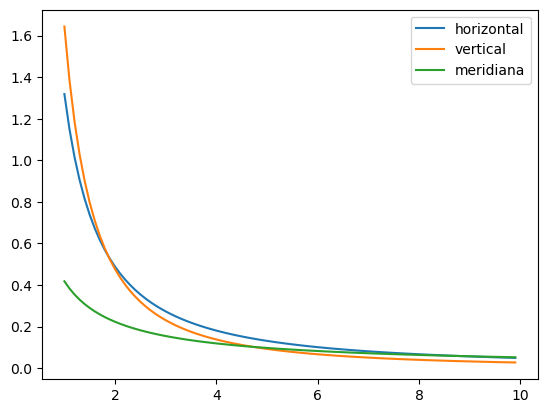

In [33]:
fr = np.arange(10,100)/10
plt.plot(fr,1.319*fr**(-1.434),label='horizontal')
plt.plot(fr,1.644*fr**(-1.788),label='vertical')
plt.plot(fr,0.418*fr**(-0.906),label='meridiana')
plt.legend()

# 结果转栅格

In [11]:
from utils import to_raster
import os
import numpy as np
from osgeo import gdal
import pandas as pd

In [7]:
cwd = os.getcwd()

In [24]:

i =gdal.Open(f'./{name}_res/{name}_1-0001.wd').ReadAsArray()

for f in os.listdir(f'./{name}_res'):
    if f.endswith('.wd'):
        temp =  gdal.Open(f'./{name}_res/'+f).ReadAsArray()
        i = np.dstack((i,temp))
maxdepth = np.max(i, axis=2)
to_raster(maxdepth,f'./1_wdmax/{name}.txt')


In [32]:
cwd = f'./{name}_res/'
files = [f for f in os.listdir(cwd) if f.endswith('.wd')]
wds = [gdal.Open(os.path.join(cwd, f)).ReadAsArray() for f in files]
max_wd = np.max(np.dstack(wds),axis=-1)
to_raster(max_wd,f'./1_wdmax/{name}.txt')

In [33]:
files = set([f.split('.')[0] for f in os.listdir(f'./{name}_res') if f.endswith('.Vx') or f.endswith('.Vy') or f.endswith('.wd')])
files = [f for f in files if os.path.exists(f'./{name}_res/{f}.wd') and os.path.exists(f'./{name}_res/{f}.Vx') and os.path.exists(f'./{name}_res/{f}.Vy')]
haz = [[gdal.Open(f'./{name}_res/'+f+item).ReadAsArray() for item in ['.wd','.Vx','.Vy']] for f in files]
haz = [h[0] + (np.max([h[1][:,:-1],h[1][:,1:]],axis=0)**2 + np.max([h[2][:-1],h[2][1:]],axis=0)**2)/2/9.8 for h in haz]
max_haz = np.max(np.dstack(haz),axis=-1)
to_raster(max_haz,f'./1_hazmax/{name}.txt')

# 积水深度

In [103]:
landuse = gdal.Open('landuse.txt').ReadAsArray()

In [106]:
depth_files = os.listdir('./workdir/1_wdmax/')

In [107]:
ded = pd.DataFrame()
for de_file in depth_files:
    de = gdal.Open('./workdir/1_wdmax/'+de_file).ReadAsArray()
    de = de[landuse>0]
    ded[de_file.split('.')[0]] = [np.where((de>a)*(de<=b),1,0).sum() for a,b in [(0,0.1),(0.1,0.5),(0.5,1),(1,1.5),(1.5,2)]]+[np.where(de>2,1,0).sum()]

In [108]:
ded*4

,100y,10y,150y,200y,30y,50y
0,118244,101324,120604,123040,108932,113072
1,77220,41948,86040,90052,57804,65520
2,10956,4408,14920,19052,5780,7284
3,2472,928,3280,3656,2292,2108
4,956,296,972,1236,532,564
5,324,584,840,1268,720,576


# 内涝风险

In [1]:
from utils import to_raster
import os
import numpy as np
from osgeo import gdal
import pandas as pd

In [2]:
os.chdir('d:\他山之石\HeXinyu\Res_repository')

In [41]:
landuse = gdal.Open('landuse.txt').ReadAsArray()
resident = np.where(landuse==1, 1, 0)
commerce = np.where(landuse==2, 1, 0)
greenland = np.where(landuse==3, 1, 0)
road = np.where(landuse==4, 1, 0)
public = np.where(landuse==5, 1, 0)
water = np.where(landuse==6, 0, 0)

In [62]:
name = '200y'
mhaz = gdal.Open(f'./workdir/1_hazmax/{name}.txt').ReadAsArray()

In [63]:
loss_res = np.clip(np.interp(mhaz*resident,[0,0.1,0.5,1,1.5,2,3,4,5,6],[0,0,0.17,0.33,0.44,0.56,0.79,1,1,1]),0,1)*874.73*10
loss_com = np.clip(np.interp(mhaz*commerce,[0,0.1,0.5,1,1.5,2,3,4,5,6],[0,0,0.14,0.34,0.53,0.72,0.98,1,1,1]),0,1)*1372.12*10
loss_roa = np.clip(np.interp(mhaz*road,[0,0.15,0.5,1,1.5,2,3,4,5,6],[0,0,0.36,0.57,0.73,0.85,1,1,1,1]),0,1)*361.39*10
loss_pub = np.clip(np.interp(mhaz*public,[0,0.15,0.5,1,1.5,2,3,4,5,6],[0,0,0.25,0.42,0.55,0.65,0.8,0.9,1,1]),0,1)*416.52*10
loss_gre = np.clip(np.interp(mhaz*greenland,[0,0.15,0.5,1,1.5,2,3,4,5,6],[0,0,0.26,0.47,0.62,0.91,1,1,1,1]),0,1)*179.14*10
loss = loss_res+loss_roa+loss_com+loss_gre+loss_pub
to_raster(loss,f'./workdir/1_risk/{name}.txt')

In [4]:
losses = [gdal.Open(f'./workdir/1_risk/{di}').ReadAsArray() for di in sorted(os.listdir('./workdir/1_risk'),key=lambda x:int(x.strip('y.txt')))]
[loss[loss>-9999].sum()/1000000 for loss in losses]

[9.403828, 15.745985, 18.95195, 26.298654, 32.69467, 36.939556]

# 内涝韧性

In [1]:
import matplotlib.pyplot as plt
from utils import to_raster
import os
import numpy as np
from osgeo import gdal
plt.rc('font',family='Times New Roman')

In [2]:
os.chdir('d:\他山之石\HeXinyu\Res_repository')

In [3]:
landuse = gdal.Open('landuse.txt').ReadAsArray()
resident = np.where(landuse==1, 1, 0)
commerce = np.where(landuse==2, 1, 0)
greenland = np.where(landuse==3, 1, 0)
road = np.where(landuse==4, 1, 0)
public = np.where(landuse==5, 1, 0)
water = np.where(landuse==6, 0, 0)

In [64]:
name = '200y'
files = [f'./workdir/{name}_res/'+fi for fi in os.listdir(f'./workdir/{name}_res') if fi.endswith('.wd')]
files = sorted(files,key=lambda x:int(os.path.basename(x).split('-')[0].split('_')[1]))[:240]

In [65]:

res = np.zeros_like(landuse,dtype=np.float64)
for f in files:
    wd = gdal.Open(f).ReadAsArray()

    resident_depth = wd*resident
    com_depth = wd*commerce
    gre_depth = wd*greenland
    road_depth = wd*road
    pub_depth = wd*public
    water_depth = wd*water


    green_res = greenland - gre_depth/2.0
    water_res =water - water_depth/2.0
    green_res[green_res < 0] = 0
    water_res[water_res < 0] = 0


    resident_res = resident - resident_depth/0.3
    com_res = commerce - com_depth/0.3
    road_res = road - road_depth/0.3
    pub_res = public - pub_depth/0.3
    resident_res[resident_res < 0] = 0
    com_res[com_res < 0] = 0
    road_res[road_res < 0] = 0
    pub_res[pub_res < 0] = 0


    res += (green_res+water_res+resident_res+com_res+road_res+pub_res)
res /= len(files)


In [66]:
res = -9999*(landuse==-9999) + res*(landuse>-9999)
to_raster(res,f'./workdir/1_resilience/{name}.txt')


In [67]:
ress = [gdal.Open(f'./workdir/1_resilience/{di}').ReadAsArray() for di in sorted(os.listdir('./workdir/1_resilience'),key=lambda x:int(x.strip('y.txt')))]
[res[res>-9999].mean() for res in ress]

[0.9915326, 0.9886918, 0.9877602, 0.9853978, 0.9837921, 0.9828714]

In [4]:
lutps = [greenland,water,resident,commerce,road,public]
thress = [2,2,0.3,0.3,0.3,0.3]

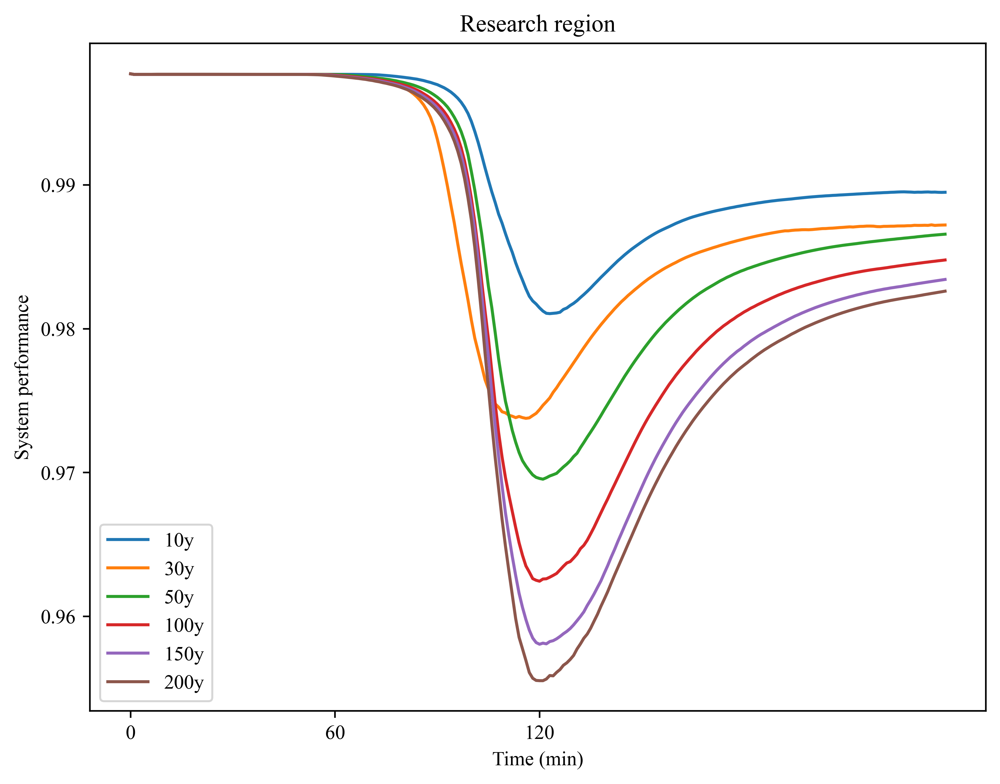

In [15]:
fig,ax = plt.subplots(1,1,figsize=(8,6),dpi=500)
lines = []
for rain in [10,30,50,100,150,200]:
    name = f'{rain}y'
    files = [f'./workdir/{name}_res/'+fi for fi in os.listdir(f'./workdir/{name}_res') if fi.endswith('.wd')]
    files = sorted(files,key=lambda x:int(os.path.basename(x).split('-')[0].split('_')[1]))[:240]
    wds = [gdal.Open(f).ReadAsArray() for f in files]
    res = np.array([np.sum([np.clip(typ - typ*wd/thres,0,1) for typ,thres in zip(lutps,thress)],axis=0) for wd in wds])
    lines += ax.plot(res[:,landuse>-9999].mean(axis=-1),label=name)
    ax.set_xlabel('Time (min)')
    ax.set_xticks([0,60,120])
    ax.set_ylabel('System performance')
    ax.set_title('Research region')
    ax.legend()


# 水深过程图

In [53]:
import matplotlib.pyplot as plt
from utils import to_raster
import os
import numpy as np
from osgeo import gdal
import geopandas as gpd
plt.rc('font',family='Times New Roman')


In [37]:
os.chdir('d:\他山之石\HeXinyu\Res_repository')

In [38]:
points = gpd.read_file('../figures/EFGH/EFGH.shp')
with gdal.Open('landuse.txt') as ds
    gt = ds.GetGeoTransform()
points['x'],points['y'] = ((points.geometry.x - gt[0])//gt[1]).astype(int),((points.geometry.y - gt[3])//gt[5]).astype(int)
points = points.set_index('Name').sort_index()
points

,Id,geometry,x,y
Name,,,,
A,0,POINT (581784.326 3497136.647),339,214
B,0,POINT (581895.671 3496529.207),395,517
C,0,POINT (581795.680 3496463.456),345,550
D,0,POINT (581373.321 3496326.208),134,619
E,0,POINT (581957.116 3496231.178),426,666
F,0,POINT (582207.935 3496700.360),551,432
G,0,POINT (581509.989 3496122.839),202,721


In [49]:
with gdal.Open('landuse.txt') as ds:
    print(ds.GetGeoTransform(),ds.RasterXSize,ds.RasterYSize,ds.ReadAsArray().shape)

((581104.93977053, 2.0, 0.0, 3497565.0924656, 0.0, -2.0), 694, 824, (824, 694))

In [51]:
pnts = points.loc[['A','B','F','G']]
files = [[f'./workdir/{name}y_res/'+fi for fi in os.listdir(f'./workdir/{name}y_res') if fi.endswith('.wd')] for name in [10,30,50,100,150,200]]
files = [sorted(file,key=lambda x:int(os.path.basename(x).split('-')[0].split('_')[1]))[:240] for file in files]
wds = np.array([[gdal.Open(f).ReadAsArray()[pnts['y'],pnts['x']] for f in file] for file in files])

In [50]:
with gdal.Open(files[0][0]) as ds:
    print(ds.GetGeoTransform(),ds.RasterXSize,ds.RasterYSize,ds.ReadAsArray().shape)

((581104.939801, 2.0, 0.0, 3497565.092414, 0.0, -2.0), 694, 824, (824, 694))

In [61]:
res = gdal.Open(f'./workdir/1_resilience/200y.txt').ReadAsArray()
res = res[pnts['y'],pnts['x']]

In [9]:
wds.shape

(6, 240, 4)

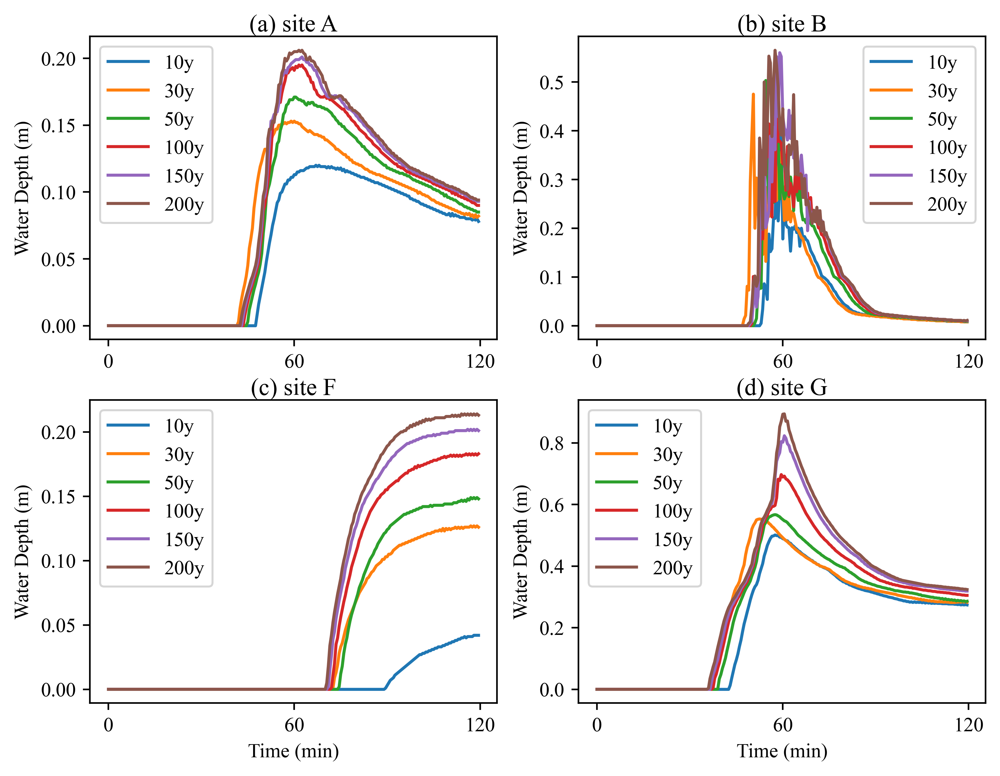

In [73]:
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(8,6),dpi=500)
for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    lines = []
    for j,rain in enumerate([10,30,50,100,150,200]):
        lines += ax.plot(np.arange(wds.shape[1])/2,wds[j,:,i],label=f'{rain}y')
    if i>1:
        ax.set_xlabel('Time (min)')
    ax.set_xticks([0,60,120])
    ax.set_ylabel('Water Depth (m)')
    ax.set_title('({}) site {}'.format('abcd'[i],'ABFG'[i]), transform=ax.transAxes)
    ax.legend()
   

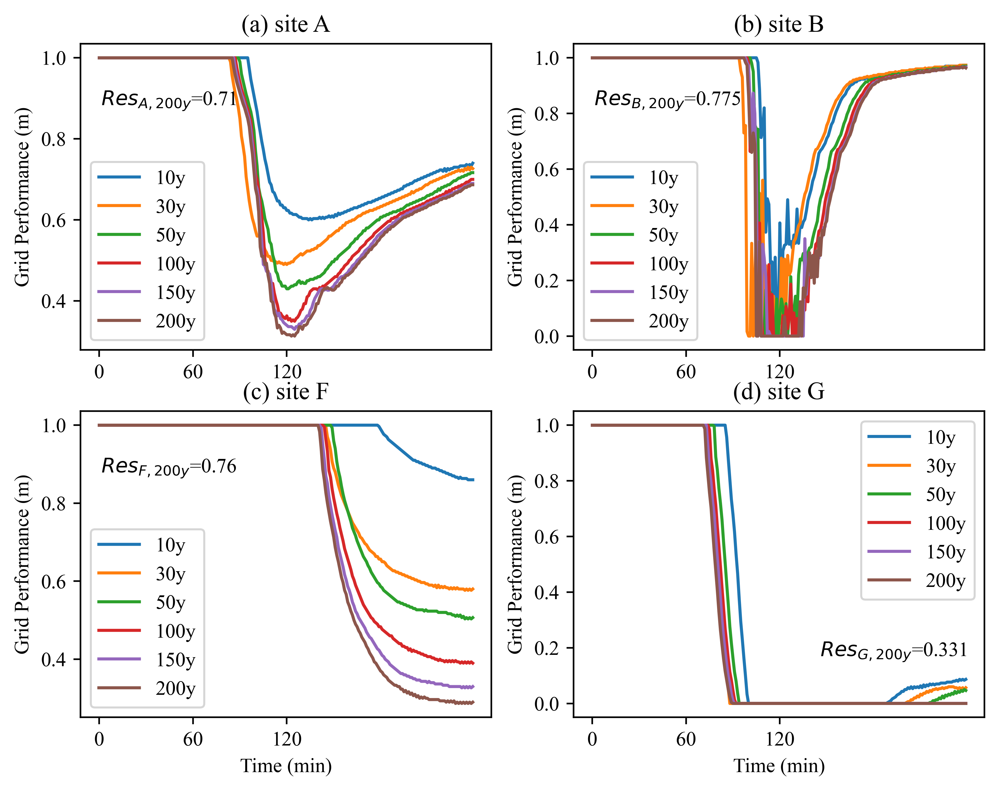

In [88]:
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(8,6),dpi=500)
for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    lines = []
    for j,rain in enumerate([10,30,50,100,150,200]):
        lines += ax.plot([max(dat,0) for dat in 1-wds[j,:,i]/0.3],label=f'{rain}y')
    if i>1:
        ax.set_xlabel('Time (min)')
    ax.set_xticks([0,60,120])
    ax.set_ylabel('Grid Performance (m)')
    ax.set_title('({}) site {}'.format('abcd'[i],'ABFG'[i]))
    ax.text(0.05 if i<3 else 0.6,0.8 if i<3 else 0.2,'$Res_{%s,200y}$'%'ABFG'[i]+'=%s'%res[i],transform=ax.transAxes)
    ax.legend()
   

# 分类结果

In [13]:
name = '200y'
landuse = gdal.Open('landuse.txt').ReadAsArray()
landuse = (landuse>-9999).astype(np.int32)

In [14]:
loss = gdal.Open(f'./workdir/1_risk/{name}.txt').ReadAsArray()
res = gdal.Open(f'./workdir/1_resilience/{name}.txt').ReadAsArray()

In [15]:
loss_thres = [np.percentile(loss[landuse>0],i) for i in [99,97,95,93,91]]
loss_thres

[2475.2626953125,
 1354.1665344238281,
 669.1480255126953,
 283.45098876953125,
 28.815000534057617]

In [16]:
res_thres = [np.percentile(res[landuse>0],i) for i in [1,3,5,7,9]]
res_thres

[0.5830000042915344,
 0.8180000185966492,
 0.9049999713897705,
 0.9480000138282776,
 0.972000002861023]

In [17]:
tl,tr = loss_thres[0],  res_thres[0]
scen = np.where((loss>=tl)*(res<=tr),1,0)
scen += np.where((loss>=tl)*(res>tr),2,0)
scen += np.where((loss<tl)*(res<=tr),3,0)
scen += np.where((loss<tl)*(res>tr),4,0)
scen *= landuse

In [18]:
classes = {}
for i,(tl,tr) in enumerate(zip(loss_thres,res_thres)):
    scen = np.where((loss>=tl)*(res<=tr),1,0)
    scen += np.where((loss>=tl)*(res>tr),2,0)
    scen += np.where((loss<tl)*(res<=tr),3,0)
    scen += np.where((loss<tl)*(res>tr),4,0)
    scen *= landuse
    classes[i+1] = np.bincount(scen.flatten())[1:].tolist()
    to_raster(scen,'./workdir/1_class/T%s.txt'%(i+1))


In [19]:
classes

{1: [594, 2756, 2765, 328811],
 2: [4093, 5955, 5981, 318897],
 3: [9433, 7314, 7340, 310839],
 4: [16175, 7275, 7318, 304158],
 5: [23526, 6619, 6809, 297972]}